In [1]:
# Initialize Otter
import otter
grader = otter.Notebook("lab4.ipynb")

# Lab 4: Putting it all together in a mini project

For this lab, **you can choose to work alone of in a group of up to four students**. You are in charge of how you want to work and who you want to work with. Maybe you really want to go through all the steps of the ML process yourself or maybe you want to practice your collaboration skills, it is up to you! Just remember to indicate who your group members are (if any) when you submit on Gradescope. If you choose to work in a group, you only need to use one GitHub repo (you can create one on github.ubc.ca and set the visibility to "public").

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## Submission instructions
rubric={mechanics}

<p>You receive marks for submitting your lab correctly, please follow these instructions:</p>

<ul>
  <li><a href="https://ubc-mds.github.io/resources_pages/general_lab_instructions/">
      Follow the general lab instructions.</a></li>
  <li><a href="https://github.com/UBC-MDS/public/tree/master/rubric">
      Click here to view a description of the rubrics used to grade the questions</a></li>
  <li>Make at least three commits.</li>
  <li>Push your <code>.ipynb</code> file to your GitHub repository for this lab and upload it to Gradescope.</li>
    <ul>
      <li>Before submitting, make sure you restart the kernel and rerun all cells.</li>
    </ul>
  <li>Also upload a <code>.pdf</code> export of the notebook to facilitate grading of manual questions (preferably WebPDF, you can select two files when uploading to gradescope)</li>
  <li>Don't change any variable names that are given to you, don't move cells around, and don't include any code to install packages in the notebook.</li>
  <li>The data you download for this lab <b>SHOULD NOT BE PUSHED TO YOUR REPOSITORY</b> (there is also a <code>.gitignore</code> in the repo to prevent this).</li>
  <li>Include a clickable link to your GitHub repo for the lab just below this cell
    <ul>
      <li>It should look something like this https://github.ubc.ca/MDS-2020-21/DSCI_531_labX_yourcwl.</li>
    </ul>
  </li>
</ul>
</div>

_Points:_ 2

https://github.ubc.ca/nassim9/573-lab4-Airbnb-Popularity-NEWYORK.git

<!-- END QUESTION -->

## Introduction <a name="in"></a>

In this lab you will be working on an open-ended mini-project, where you will put all the different things you have learned so far in 571 and 573 together to solve an interesting problem.

A few notes and tips when you work on this mini-project: 

#### Tips
1. Since this mini-project is open-ended there might be some situations where you'll have to use your own judgment and make your own decisions (as you would be doing when you work as a data scientist). Make sure you explain your decisions whenever necessary. 
2. **Do not include everything you ever tried in your submission** -- it's fine just to have your final code. That said, your code should be reproducible and well-documented. For example, if you chose your hyperparameters based on some hyperparameter optimization experiment, you should leave in the code for that experiment so that someone else could re-run it and obtain the same hyperparameters, rather than mysteriously just setting the hyperparameters to some (carefully chosen) values in your code. 
3. If you realize that you are repeating a lot of code try to organize it in functions. Clear presentation of your code, experiments, and results is the key to be successful in this lab. You may use code from lecture notes or previous lab solutions with appropriate attributions. 

#### Assessment
We don't have some secret target score that you need to achieve to get a good grade. **You'll be assessed on demonstration of mastery of course topics, clear presentation, and the quality of your analysis and results.** For example, if you just have a bunch of code and no text or figures, that's not good. If you instead do a bunch of sane things and you have clearly motivated your choices, but still get lower model performance than your friend, don't sweat it.


#### A final note
Finally, the style of this "project" question is different from other assignments. It'll be up to you to decide when you're "done" -- in fact, this is one of the hardest parts of real projects. But please don't spend WAY too much time on this... perhaps "several hours" but not "many hours" is a good guideline for a high quality submission. Of course if you're having fun you're welcome to spend as much time as you want! But, if so, try not to do it out of perfectionism or getting the best possible grade. Do it because you're learning and enjoying it. Students from the past cohorts have found such kind of labs useful and fun and we hope you enjoy it as well. 

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 1. Pick your problem and explain the prediction problem <a name="1"></a>
rubric={reasoning}

In this mini project, you will pick one of the following problems: 

1. A classification problem of predicting whether a credit card client will default or not. For this problem, you will use [Default of Credit Card Clients Dataset](https://www.kaggle.com/uciml/default-of-credit-card-clients-dataset). In this data set, there are 30,000 examples and 24 features, and the goal is to estimate whether a person will default (fail to pay) their credit card bills; this column is labeled "default.payment.next.month" in the data. The rest of the columns can be used as features. You may take some ideas and compare your results with [the associated research paper](https://www.sciencedirect.com/science/article/pii/S0957417407006719), which is available through [the UBC library](https://www.library.ubc.ca/). 

OR 

2. A regression problem of predicting `reviews_per_month`, as a proxy for the popularity of the listing with [New York City Airbnb listings from 2019 dataset](https://www.kaggle.com/dgomonov/new-york-city-airbnb-open-data). Airbnb could use this sort of model to predict how popular future listings might be before they are posted, perhaps to help guide hosts create more appealing listings. In reality they might instead use something like vacancy rate or average rating as their target, but we do not have that available here.

**Your tasks:**

1. Spend some time understanding the problem and what each feature means. Write a few sentences on your initial thoughts on the problem and the dataset. 
2. Download the dataset and read it as a pandas dataframe. 
3. Carry out any preliminary preprocessing, if needed (e.g., changing feature names, handling of NaN values etc.)
    
</div>

_Points:_ 3

_Type your answer here, replacing this text._

In [2]:
#imports
import sklearn # for tests
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import altair_ally as aly
import altair as alt
from xgboost import XGBRegressor
from sklearn.feature_selection import RFECV
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import cross_validate

from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import (
    MinMaxScaler,
    OneHotEncoder,
    OrdinalEncoder,
    StandardScaler,
)
from sklearn.compose import ColumnTransformer
from sklearn.dummy import DummyRegressor
from sklearn.pipeline import make_pipeline


In [3]:
data= pd.read_csv('data/AB_NYC_2019.csv')

data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 2. Data splitting <a name="2"></a>
rubric={reasoning}

**Your tasks:**

1. Split the data into train and test portions.

> Make the decision on the `test_size` based on the capacity of your laptop. 
    
</div>

_Points:_ 1

In [4]:
train_df, test_df = train_test_split(data, test_size = 0.4, random_state=123)
train_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
17877,14010200,"Scandinavean design in Crown Heights, BK",1683437,Boram,Brooklyn,Crown Heights,40.66477,-73.95060,Entire home/apt,89,5,9,2018-05-28,0.25,1,0
14638,11563821,Private bedroom located in the heart of Chelsea,10307134,Anna,Manhattan,Chelsea,40.74118,-74.00012,Private room,110,1,48,2019-06-16,1.80,2,67
7479,5579629,Lovely sunlit room in Brooklyn,329917,Clémentine,Brooklyn,Greenpoint,40.72905,-73.95755,Private room,53,2,5,2016-10-21,0.13,1,0
47058,35575853,"Great view, 1 BR right next to Central Park!",35965489,Meygan,Manhattan,East Harlem,40.79755,-73.94797,Private room,100,2,0,NaN,NaN,1,7
9769,7509362,Great BIG Upper West Side Apartment,29156329,Andrew,Manhattan,Upper West Side,40.80120,-73.96382,Private room,87,3,9,2018-09-19,0.19,1,0


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 3. EDA <a name="3"></a>
rubric={viz,reasoning}
    
Perform exploratory data analysis on the train set.

**Your tasks:**

1. Include at least two summary statistics and two visualizations that you find useful, and accompany each one with a sentence explaining it.
2. Summarize your initial observations about the data. 
3. Pick appropriate metric/metrics for assessment. 
    
</div>

_Points:_ 6

_Type your answer here, replacing this text._

In [5]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29337 entries, 17877 to 15725
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              29337 non-null  int64  
 1   name                            29328 non-null  object 
 2   host_id                         29337 non-null  int64  
 3   host_name                       29325 non-null  object 
 4   neighbourhood_group             29337 non-null  object 
 5   neighbourhood                   29337 non-null  object 
 6   latitude                        29337 non-null  float64
 7   longitude                       29337 non-null  float64
 8   room_type                       29337 non-null  object 
 9   price                           29337 non-null  int64  
 10  minimum_nights                  29337 non-null  int64  
 11  number_of_reviews               29337 non-null  int64  
 12  last_review                     2

In [6]:
train_df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,29337.0,1.891988e+07,1.102155e+07,2539.00000,9.350729e+06,1.951751e+07,2.916531e+07,3.648561e+07
host_id,29337.0,6.714579e+07,7.835404e+07,2438.00000,7.740184e+06,3.071907e+07,1.064429e+08,2.743213e+08
latitude,29337.0,4.072901e+01,5.459419e-02,40.50641,4.069009e+01,4.072314e+01,4.076328e+01,4.091234e+01
longitude,29337.0,-7.395222e+01,4.609134e-02,-74.24442,-7.398303e+01,-7.395553e+01,-7.393643e+01,-7.371299e+01
price,29337.0,1.509391e+02,2.282242e+02,0.00000,6.900000e+01,1.070000e+02,1.750000e+02,1.000000e+04
minimum_nights,29337.0,7.141971e+00,2.227211e+01,1.00000,1.000000e+00,3.000000e+00,5.000000e+00,1.250000e+03
number_of_reviews,29337.0,2.335450e+01,4.469248e+01,0.00000,1.000000e+00,5.000000e+00,2.300000e+01,6.290000e+02
reviews_per_month,23386.0,1.369867e+00,1.706732e+00,0.01000,1.900000e-01,7.100000e-01,2.010000e+00,5.850000e+01
calculated_host_listings_count,29337.0,7.003340e+00,3.251162e+01,1.00000,1.000000e+00,1.000000e+00,2.000000e+00,3.270000e+02
availability_365,29337.0,1.128036e+02,1.315445e+02,0.00000,0.000000e+00,4.500000e+01,2.270000e+02,3.650000e+02


In [7]:
def missing_zero_values_table(df):

    zero_val = (df == 0.00).astype(int).sum(axis=0)
    mis_val = df.isnull().sum()
    mis_val_percent = 100 * df.isnull().sum() / len(df)
    mz_table = pd.concat([zero_val, mis_val, mis_val_percent], axis=1)
    mz_table = mz_table.rename(
    columns = {0 : 'Zero Values', 1 : 'Missing Values', 2 : '% of Total Values'})
    mz_table['Total Zero Missing Values'] = mz_table['Zero Values'] + mz_table['Missing Values']
    mz_table['% Total Zero Missing Values'] = 100 * mz_table['Total Zero Missing Values'] / len(df)
    mz_table['Data Type'] = df.dtypes
    mz_table = mz_table[
        mz_table.iloc[:,1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)
    print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
           "There are " + str(mz_table.shape[0]) +
              " columns that have missing values.")
    return mz_table
missing_zero_values_table(train_df)

Your selected dataframe has 16 columns and 29337 Rows.
There are 4 columns that have missing values.


,Zero Values,Missing Values,% of Total Values,Total Zero Missing Values,% Total Zero Missing Values,Data Type
last_review,0,5951,20.3,5951,20.3,object
reviews_per_month,0,5951,20.3,5951,20.3,float64
host_name,0,12,0.0,12,0.0,object
name,0,9,0.0,9,0.0,object


In [8]:
train_df.nunique()

id                                29337
name                              28894
host_id                           23964
host_name                          8375
neighbourhood_group                   5
neighbourhood                       217
latitude                          15269
longitude                         12151
room_type                             3
price                               591
minimum_nights                       94
number_of_reviews                   360
last_review                        1632
reviews_per_month                   867
calculated_host_listings_count       47
availability_365                    366
dtype: int64

In [9]:

aly.alt.data_transformers.enable('vegafusion')

aly.dist(train_df)

alt.ConcatChart(...)

In [10]:
aly.corr(train_df)

/Users/nasim/miniconda3/envs/573/lib/python3.11/site-packages/altair/utils/deprecation.py:65: AltairDeprecationWarning: 'selection_multi' is deprecated.  Use 'selection_point'
  warnings.warn(message, AltairDeprecationWarning, stacklevel=1)
/Users/nasim/miniconda3/envs/573/lib/python3.11/site-packages/altair/vegalite/v5/api.py:394: AltairDeprecationWarning: The value of 'empty' should be True or False.
  warnings.warn(
/Users/nasim/miniconda3/envs/573/lib/python3.11/site-packages/altair/utils/deprecation.py:65: AltairDeprecationWarning: 'add_selection' is deprecated. Use 'add_params' instead.
  warnings.warn(message, AltairDeprecationWarning, stacklevel=1)
/Users/nasim/miniconda3/envs/573/lib/python3.11/site-packages/altair/utils/deprecation.py:65: AltairDeprecationWarning: 'add_selection' is deprecated. Use 'add_params' instead.
  warnings.warn(message, AltairDeprecationWarning, stacklevel=1)


alt.ConcatChart(...)

Text(0.5, 1.0, 'Room Type vs reviews_per_month')

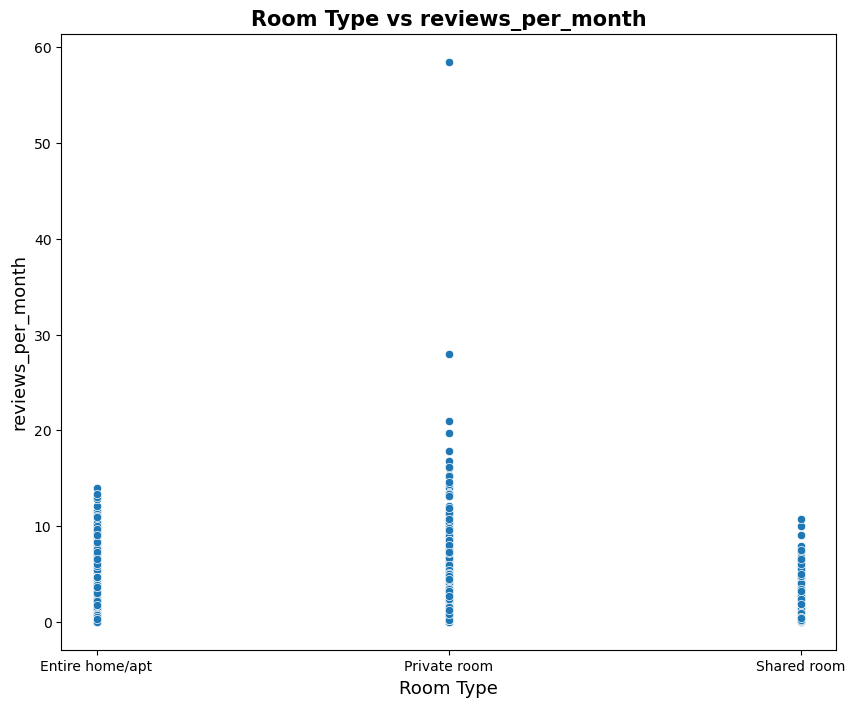

In [11]:
plt.figure(figsize=(10,8))
sns.scatterplot(x='room_type', y='reviews_per_month', data=train_df)

plt.xlabel("Room Type", size=13)
plt.ylabel("reviews_per_month", size=13)
plt.title("Room Type vs reviews_per_month",size=15, weight='bold')

Text(0.5, 1.0, 'Neighbourhood Group vs reviews_per_month')

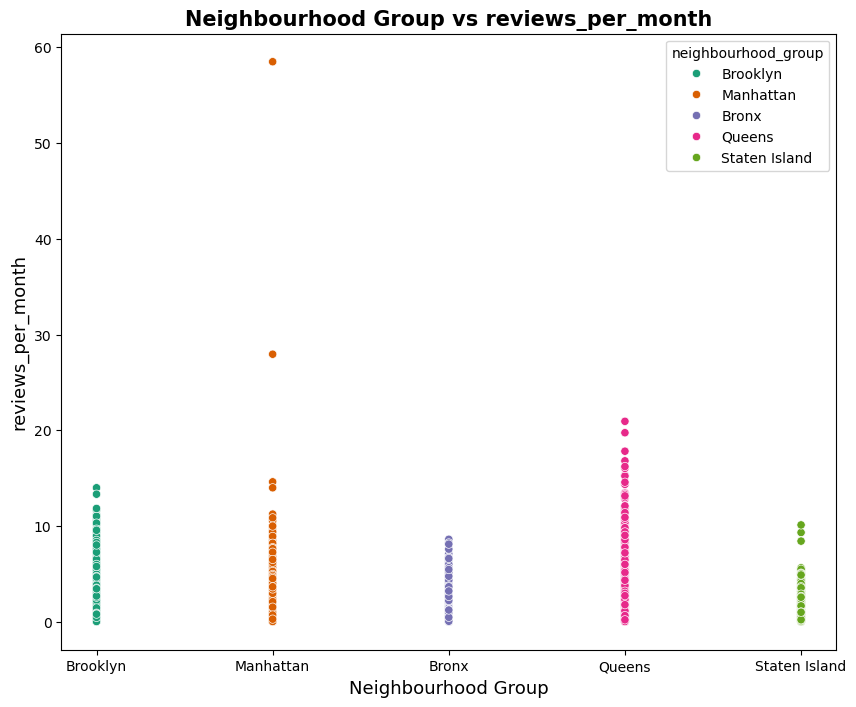

In [12]:
plt.figure(figsize=(10,8))
sns.scatterplot(x='neighbourhood_group', y='reviews_per_month', data=train_df, hue='neighbourhood_group', palette="Dark2")

plt.xlabel("Neighbourhood Group", size=13)
plt.ylabel("reviews_per_month", size=13)
plt.title("Neighbourhood Group vs reviews_per_month",size=15, weight='bold')

In [13]:
alt.data_transformers.enable('vegafusion')
categ_cols = ['neighbourhood_group', 'room_type']
categ_cols_dist = alt.Chart(train_df).mark_bar().encode(
    x = alt.X(alt.repeat(),type= "nominal"),
    y ="count()",
).properties(
        width = 500,
        height = 150
).repeat(
    categ_cols,
    columns = 1
)
categ_cols_dist

alt.RepeatChart(...)

In [14]:
last_reviw_plot = alt.Chart(train_df).mark_bar().encode(
    x = alt.X('last_review:T'),
    y =alt.Y("count()")
).properties(
        width = 500,
        height = 250
)
last_reviw_plot

alt.Chart(...)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 4. Feature engineering (Challenging)
rubric={reasoning}

**Your tasks:**

1. Carry out feature engineering. In other words, extract new features relevant for the problem and work with your new feature set in the following exercises. You may have to go back and forth between feature engineering and preprocessing.
    
</div>

_Points:_ 0.5

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 5. Preprocessing and transformations <a name="5"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Identify different feature types and the transformations you would apply on each feature type. 
2. Define a column transformer, if necessary. 
    
</div>

_Points:_ 4

We need to drop id and host name columns as they are unique identifiers. Transform price, date of last review, number of reviews, and transform the categorical features such as neighborhood by onehot encloding. Create binary flags indicating whether a review happened in the last week, last month, etc.Calculate the time elapsed since the last review. This could capture how recent or outdated the information is.Encode the season in which the last review occurred. This can be particularly useful if there are seasonal patterns in your data and then drop the date column.

In [15]:

train_df['reviews_per_month'] = train_df['reviews_per_month'].fillna(0)
test_df['reviews_per_month'] = test_df['reviews_per_month'].fillna(0)

X_train = train_df.drop(columns=['reviews_per_month'])
y_train = train_df['reviews_per_month']
X_test = test_df.drop(columns=['reviews_per_month'])
y_test = test_df['reviews_per_month']


categorical_features = ['room_type', 
                        'neighbourhood_group']
numeric_features =['latitude', 
                   'longitude', 
                   'price', 
                   'minimum_nights',
                   'calculated_host_listings_count',
                    'availability_365']
drop_features = ['last_review',
                  'id', 
                  'name', 
                  'host_id', 
                  'host_name',
                  'neighbourhood']


In [16]:
numeric_transformer = make_pipeline(
    PolynomialFeatures(degree=2),
    StandardScaler()
)

categorical_transformer = make_pipeline(
    OneHotEncoder(handle_unknown='ignore')
)

preprocessor = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features), 
    ('drop', drop_features)
)


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 6. Baseline model <a name="6"></a>
rubric={accuracy}

**Your tasks:**
1. Train a baseline model for your task and report its performance.
    
</div>

_Points:_ 2

In [17]:
model_dummy = DummyRegressor()

pipe_dummy = make_pipeline(preprocessor, model_dummy)

cv_df = pd.DataFrame(cross_validate(pipe_dummy, 
                                    X_train, 
                                    y_train, 
                                    return_train_score=True,
                                    scoring='r2'
))
cv_df

,fit_time,score_time,test_score,train_score
0,0.018164,0.004521,-2.209298e-04,0.0
1,0.019550,0.004481,-1.822243e-04,0.0
2,0.018005,0.003980,-1.327336e-04,0.0
3,0.017471,0.004622,-1.944606e-07,0.0
4,0.018413,0.003985,-3.851852e-04,0.0


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 7. Linear models <a name="7"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Try a linear model as a first real attempt. 
2. Carry out hyperparameter tuning to explore different values for the regularization hyperparameter. 
3. Report cross-validation scores along with standard deviation. 
4. Summarize your results.
    
</div>

_Points:_ 8

_Type your answer here, replacing this text._

In [18]:
cross_val_results = {}

ridge = make_pipeline(preprocessor,PolynomialFeatures(2), Ridge())

cv_df = pd.DataFrame(cross_validate(ridge, X_train, y_train, scoring='r2', return_train_score=True, cv=10))
cv_df
cross_val_results['ridge'] = cv_df.agg(['mean', 'std']).round(3).T
cross_val_results['ridge']

,mean,std
fit_time,0.310,0.098
score_time,0.009,0.001
test_score,-7.061,21.673
train_score,0.255,0.003


In [19]:
from sklearn.linear_model import LassoCV
from sklearn.linear_model import Lasso

lasso = make_pipeline(preprocessor, LassoCV(max_iter=20000, tol= 0.01))

cv_df= pd.DataFrame(cross_validate(lasso, X_train, y_train, return_train_score=True, cv=10))

In [20]:
cross_val_results['lasso'] = cv_df.agg(['mean', 'std']).round(3).T
cross_val_results['lasso']

,mean,std
fit_time,0.406,0.128
score_time,0.003,0.000
test_score,0.148,0.011
train_score,0.153,0.016


In [24]:
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import RidgeCV

lasso_ridge = make_pipeline(
    preprocessor, SelectFromModel(LassoCV(max_iter=20000, tol= 0.01)),
    RidgeCV(),
)

# 2. Cross-validation
cv_df = pd.DataFrame(cross_validate(lasso_ridge, X_train, y_train, return_train_score=True, cv=10))
cv_df
cross_val_results['lasso_ridge'] = cv_df.agg(['mean', 'std']).round(3).T
cross_val_results['lasso_ridge']

,mean,std
fit_time,0.450,0.118
score_time,0.003,0.000
test_score,0.157,0.015
train_score,0.161,0.006


In [25]:
# 3. Fit and count coefficients
lasso_ridge.fit(X_train, y_train)
# Assign the best model from the pipeline to a short name for convenience
best = lasso_ridge.named_steps['ridgecv']
n_coefs_nonzero_lasso_ridge = np.count_nonzero(best.coef_)

In [26]:
rp_lasso_ridge = best.alpha_
rp_lasso_ridge

0.1

In [27]:
l=lasso_ridge.named_steps['selectfrommodel'].get_feature_names_out()

In [28]:
l=lasso_ridge.named_steps['selectfrommodel'].get_feature_names_out()
coefs_lasso_ridge = pd.DataFrame({'variable': l, 'coef':best.coef_})
coefs_lasso_ridge

,variable,coef
0,x1,3.519919
1,x2,2.330397
2,x3,0.494316
3,x4,1.340967
4,x5,-0.050743
5,x6,-0.384667
6,x7,-6.330151
7,x8,-2.893030
8,x9,-0.719433
9,x10,-1.749857


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 8. Different models <a name="8"></a>
rubric={accuracy,reasoning}

**Your tasks:**
1. Try out three other models aside from the linear model. 
2. Summarize your results in terms of overfitting/underfitting and fit and score times. Can you beat the performance of the linear model? 
    
</div>

_Points:_ 10

_Type your answer here, replacing this text._

#### RANDOM FOREST

In [ ]:
from sklearn.ensemble import RandomForestRegressor

pipe_rf = make_pipeline(
    preprocessor,
    RandomForestRegressor(max_depth=10, random_state=123)
    )

cv_rf = pd.DataFrame(cross_validate(pipe_rf, X_train, y_train, cv = 5, return_train_score = True))
cv_rf

,fit_time,score_time,test_score,train_score
0,20.543542,0.032418,0.330486,0.504915
1,20.555463,0.036705,0.306906,0.501453
2,20.407951,0.032731,0.381584,0.508905
3,20.356737,0.032794,0.357853,0.506673
4,20.198407,0.032558,0.342899,0.507063


In [ ]:


cross_val_results['randomforest'] = cv_rf.agg(['mean', 'std']).round(3).T
cross_val_results['randomforest']

,mean,std
fit_time,20.412,0.147
score_time,0.033,0.002
test_score,0.344,0.028
train_score,0.506,0.003


In [ ]:
pipe_rf.fit(X_train, y_train)
model = pipe_rf.named_steps['randomforestregressor']

In [ ]:
feature_importances_rf = model.feature_importances_
feature_importances_rf
feature_names_1 = pipe_rf.named_steps['columntransformer'].named_transformers_['pipeline-1'].get_feature_names_out().tolist()
feature_names_2 = pipe_rf.named_steps['columntransformer'].named_transformers_['pipeline-2'].get_feature_names_out().tolist()

feature_names = feature_names_1 + feature_names_2
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances_rf})
feature_importance_df.sort_values(by='Importance', ascending = False).head(10)

,Feature,Importance
15,longitude minimum_nights,0.197845
21,price availability_365,0.185610
10,latitude minimum_nights,0.111377
12,latitude availability_365,0.074145
17,longitude availability_365,0.071851
8,latitude longitude,0.041462
16,longitude calculated_host_listings_count,0.038779
20,price calculated_host_listings_count,0.030569
11,latitude calculated_host_listings_count,0.029605
26,calculated_host_listings_count availability_365,0.028600


In [ ]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)
pipe_xgb = make_pipeline(
    preprocessor,
    XGBRegressor(
        random_state=123, verbosity=0))
cv_df_xg = pd.DataFrame(cross_validate(pipe_xgb, X_train, y_train, cv = 5, return_train_score = True))
cv_df_xg

,fit_time,score_time,test_score,train_score
0,1.149508,0.005648,0.332493,0.692865
1,1.078214,0.005294,0.302324,0.687489
2,1.053628,0.005566,0.370466,0.699875
3,1.190749,0.006072,0.347683,0.704054
4,1.034901,0.005572,0.365206,0.692671


In [ ]:

cross_val_results['XGBoost'] = cv_df_xg.agg(['mean', 'std']).round(3).T
cross_val_results['XGBoost']

,mean,std
fit_time,1.101,0.066
score_time,0.006,0.000
test_score,0.344,0.028
train_score,0.695,0.007


In [ ]:
pipe_xgb.fit(X_train, y_train)
model = pipe_xgb.named_steps['xgbregressor']

In [ ]:
feature_importances_xgb = model.feature_importances_
feature_importances_xgb
feature_names_1 = pipe_xgb.named_steps['columntransformer'].named_transformers_['pipeline-1'].get_feature_names_out().tolist()
feature_names_2 = pipe_xgb.named_steps['columntransformer'].named_transformers_['pipeline-2'].get_feature_names_out().tolist()

feature_names = feature_names_1 + feature_names_2
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances_xgb})
feature_importance_df.sort_values(by='Importance', ascending = False).head(10)

,Feature,Importance
17,longitude availability_365,0.180704
21,price availability_365,0.114236
15,longitude minimum_nights,0.089334
28,room_type_Entire home/apt,0.065287
10,latitude minimum_nights,0.057335
12,latitude availability_365,0.043035
19,price minimum_nights,0.037120
26,calculated_host_listings_count availability_365,0.035704
24,minimum_nights availability_365,0.032444
33,neighbourhood_group_Manhattan,0.031137


In [ ]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)
from lightgbm.sklearn import LGBMRegressor
pipe_lgbm = make_pipeline(
    preprocessor, LGBMRegressor(random_state=123)
)
cv_df_lgbm = pd.DataFrame(cross_validate(pipe_lgbm, X_train, y_train, cv = 5, return_train_score = True))
cv_df_lgbm

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001580 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5973
[LightGBM] [Info] Number of data points in the train set: 23469, number of used features: 35
[LightGBM] [Info] Start training from score 1.087050
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001456 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5967
[LightGBM] [Info] Number of data points in the train set: 23469, number of used features: 35
[LightGBM] [Info] Start training from score 1.087324
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001191 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5970
[LightGBM] [Info] Number of data points in the train set: 23470, number of used features: 35
[LightGBM] [Info] Start tra

,fit_time,score_time,test_score,train_score
0,0.669042,0.009832,0.392953,0.523223
1,0.656192,0.009258,0.316021,0.542603
2,0.643484,0.009668,0.405498,0.531330
3,0.708140,0.009691,0.384006,0.534224
4,0.810813,0.009744,0.372930,0.534002


In [ ]:

cross_val_results['LGBMRegressor'] = cv_df_lgbm.agg(['mean', 'std']).round(3).T
cross_val_results['LGBMRegressor']

,mean,std
fit_time,0.698,0.068
score_time,0.010,0.000
test_score,0.374,0.035
train_score,0.533,0.007


In [ ]:
pipe_lgbm.fit(X_train, y_train)
model = pipe_lgbm.named_steps['lgbmregressor']

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001951 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5988
[LightGBM] [Info] Number of data points in the train set: 29337, number of used features: 35
[LightGBM] [Info] Start training from score 1.091990


In [ ]:
feature_importances_lgbm = model.feature_importances_
feature_importances_lgbm
feature_names_1 = pipe_lgbm.named_steps['columntransformer'].named_transformers_['pipeline-1'].get_feature_names_out().tolist()
feature_names_2 = pipe_lgbm.named_steps['columntransformer'].named_transformers_['pipeline-2'].get_feature_names_out().tolist()

feature_names = feature_names_1 + feature_names_2
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances_lgbm})
feature_importance_df.sort_values(by='Importance', ascending = False).head(10)

,Feature,Importance
8,latitude longitude,220
26,calculated_host_listings_count availability_365,200
15,longitude minimum_nights,184
2,longitude,181
19,price minimum_nights,181
20,price calculated_host_listings_count,180
6,availability_365,177
16,longitude calculated_host_listings_count,165
1,latitude,156
10,latitude minimum_nights,154


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 9. Feature selection (Challenging)
rubric={reasoning}

**Your tasks:**

Make some attempts to select relevant features. You may try `RFECV`, forward/backward selection or L1 regularization for this. Do the results improve with feature selection? Summarize your results. If you see improvements in the results, keep feature selection in your pipeline. If not, you may abandon it in the next exercises unless you think there are other benefits with using less features.
    
</div>

_Points:_ 0.5

_Type your answer here, replacing this text._

In [ ]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

from sklearn.feature_selection import RFECV
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
rfecv = RFECV(Ridge())

pipe_rf_rfecv = make_pipeline(
    preprocessor, rfecv, LGBMRegressor(random_state=123)
)
cv_df_rfecv = pd.DataFrame(cross_validate(pipe_rf_rfecv, X_train, y_train,cv = 10, return_train_score = True))

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3483
[LightGBM] [Info] Number of data points in the train set: 26403, number of used features: 17
[LightGBM] [Info] Start training from score 1.090539
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001180 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4045
[LightGBM] [Info] Number of data points in the train set: 26403, number of used features: 21
[LightGBM] [Info] Start training from score 1.089050
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000929 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3997
[LightGBM] [Info] Number of data points in the train set

In [ ]:
pipe_rf_rfecv.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001172 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5476
[LightGBM] [Info] Number of data points in the train set: 29337, number of used features: 32
[LightGBM] [Info] Start training from score 1.091990


Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('pipeline-1',
                                                  Pipeline(steps=[('polynomialfeatures',
                                                                   PolynomialFeatures()),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['latitude', 'longitude',
                                                   'price', 'minimum_nights',
                                                   'calculated_host_listings_count',
                                                   'availability_365']),
                                                 ('pipeline-2',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['room_type',
                                                   'neighbourhood_group']),
                                                 ('drop', 'drop',
                                                  ['last_review', 'id', 'name',
                                                   'host_id', 'host_name',
                                                   'neighbourhood'])])),
                ('rfecv', RFECV(estimator=Ridge())),
                ('lgbmregressor', LGBMRegressor(random_state=123))])

In [ ]:
rfecv_fs = pipe_rf_rfecv.named_steps["rfecv"]
rfecv_fs.n_features_


32

In [ ]:
cross_val_results = {}
cross_val_results['RFECV'] = cv_df_rfecv.agg(['mean', 'std']).round(3).T
cross_val_results['RFECV']

,mean,std
fit_time,1.227,0.115
score_time,0.006,0.001
test_score,0.302,0.095
train_score,0.410,0.156


In [ ]:
pipe_rf_rfecv.score(X_train, y_train)

0.5141234634878769

In [ ]:

pipe_rf_rfecv.score(X_test, y_test)

0.3906403264050692

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 10. Hyperparameter optimization
rubric={accuracy,reasoning}

**Your tasks:**

Make some attempts to optimize hyperparameters for the models you've tried and summarize your results. In at least one case you should be optimizing multiple hyperparameters for a single model. You may use `sklearn`'s methods for hyperparameter optimization or fancier Bayesian optimization methods.  Briefly summarize your results.
  - [GridSearchCV](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html)   
  - [RandomizedSearchCV](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RandomizedSearchCV.html)
  - [scikit-optimize](https://github.com/scikit-optimize/scikit-optimize) 
    
</div>

_Points:_ 6

_Type your answer here, replacing this text._

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 11. Interpretation and feature importances <a name="1"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Use the methods we saw in class (e.g., `eli5`, `shap`) (or any other methods of your choice) to examine the most important features of one of the non-linear models. 
2. Summarize your observations. 
    
</div>

_Points:_ 8

_Type your answer here, replacing this text._

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 12. Results on the test set <a name="12"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Try your best performing model on the test data and report test scores. 
2. Do the test scores agree with the validation scores from before? To what extent do you trust your results? Do you think you've had issues with optimization bias? 
3. Take one or two test predictions and explain them with SHAP force plots.  
    
</div>

_Points:_ 6

_Type your answer here, replacing this text._

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 13. Summary of results <a name="13"></a>
rubric={reasoning}

Imagine that you want to present the summary of these results to your boss and co-workers. 

**Your tasks:**

1. Create a table summarizing important results. 
2. Write concluding remarks.
3. Discuss other ideas that you did not try but could potentially improve the performance/interpretability . 
3. Report your final test score along with the metric you used at the top of this notebook.
    
</div>

_Points:_ 8

_Type your answer here, replacing this text._

In [ ]:
...

Ellipsis

In [ ]:
...

Ellipsis

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 14. Creating a data analysis pipeline (Challenging)
rubric={reasoning}

**Your tasks:**

- Convert this notebook into scripts to create a reproducible data analysis pipeline with appropriate documentation. Submit your project folder in addition to this notebook on GitHub and briefly comment on your organization in the text box below.
    
</div>

_Points:_ 2

_Type your answer here, replacing this text._

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 15. Your takeaway from the course (Challenging)
rubric={reasoning}

**Your tasks:**

What is your biggest takeaway from this course? 
    
</div>

_Points:_ 0.25

_Type your answer here, replacing this text._

<!-- END QUESTION -->

<div class="alert alert-danger" style="color:black">
    
**Restart, run all and export a PDF before submitting**
    
Before submitting,
don't forget to run all cells in your notebook
to make sure there are no errors
and so that the TAs can see your plots on Gradescope.
You can do this by clicking the ▶▶ button
or going to `Kernel -> Restart Kernel and Run All Cells...` in the menu.
This is not only important for MDS,
but a good habit you should get into before ever committing a notebook to GitHub,
so that your collaborators can run it from top to bottom
without issues.
    
After running all the cells,
export a PDF of the notebook (preferably the WebPDF export)
and upload this PDF together with the ipynb file to Gradescope
(you can select two files when uploading to Gradescope)
</div>

---

## Help us improve the labs

The MDS program is continually looking to improve our courses, including lab questions and content. The following optional questions will not affect your grade in any way nor will they be used for anything other than program improvement:

1. Approximately how many hours did you spend working or thinking about this assignment (including lab time)?

#Ans:

2. Do you have any feedback on the lab you be willing to share? For example, any part or question that you particularly liked or disliked?

#Ans: